# 文字を認識することはできるか
- 写真に写っている文字をそのままアウトプットできるか
- 認識した文字を要約できるか

検証にはABBYY Cloud OCR SDKのサンプルの一部を使用させて頂いています。
https://ocrsdk.abbyy.com/jp/documentation/code-samples/

# 初期設定

In [4]:
import textwrap
import os
from dotenv import load_dotenv

import google.generativeai as genai


from IPython.display import display
from IPython.display import Markdown

/Users/katsumori/miniforge3/envs/main/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
# マークダウンに変換する関数
def to_markdown(text):
    text = text.replace('•', '  *')
    return Markdown(textwrap.indent(text, '> ', predicate=lambda _: True))

In [5]:
load_dotenv('./../.env')
GEMINI_API_KEY = os.environ['GEMINI_API_KEY']
genai.configure(api_key=GEMINI_API_KEY)

# 文字を認識できるか

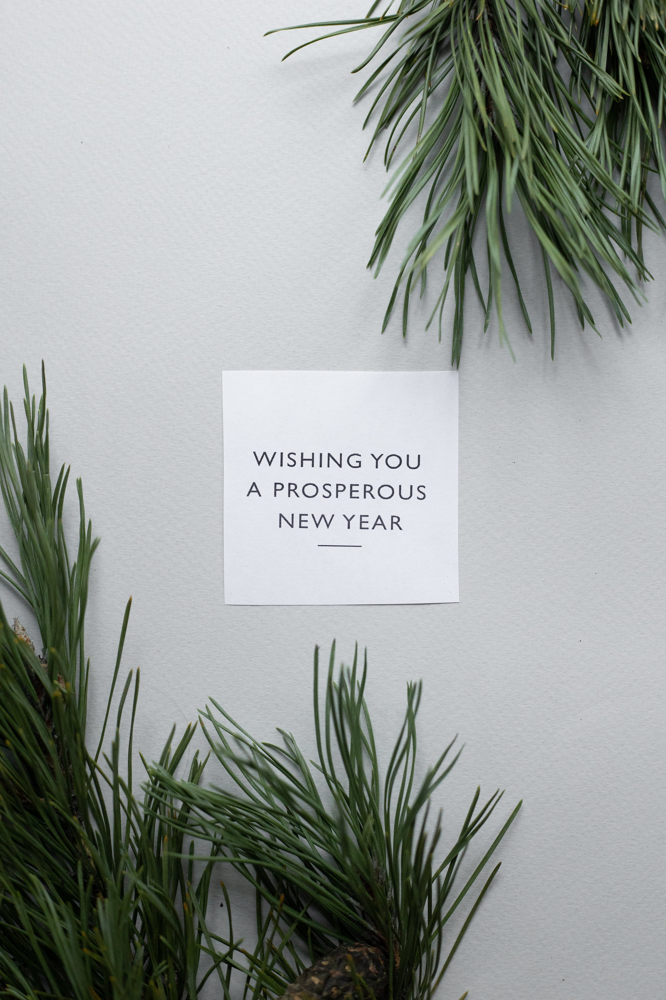

In [1]:
import PIL.Image

img = PIL.Image.open('./ocr_data/test1.jpg')
img

In [6]:
# シンプルに使用
model = genai.GenerativeModel('gemini-pro-vision')
response = model.generate_content(img)
to_markdown(response.text)

>  The image is a photo of a white card with the words "Wishing you a prosperous New Year" on it. The card is placed on a gray background and surrounded by pine branches.

In [ ]:
'''
画像はグレーの背景の年賀状で、中央に白い四角があり、黒字で「Wishing you a prosperous new year」と書かれている。
カードの両側には2本の松の枝が飾られています。
'''

## 認識した文字そのまま出力できるか

In [8]:
# data1 出力版
response = model.generate_content(["写真内の文字をそのまま出力してください。", img], stream=True)
response.resolve()
to_markdown(response.text)

>  Wishing you a prosperous new year

In [20]:
# data1 要約版
response = model.generate_content(["写真内の文字を要約して出力してください。", img], stream=True)
response.resolve()
to_markdown(response.text)

>  新年あけましておめでとうございます。

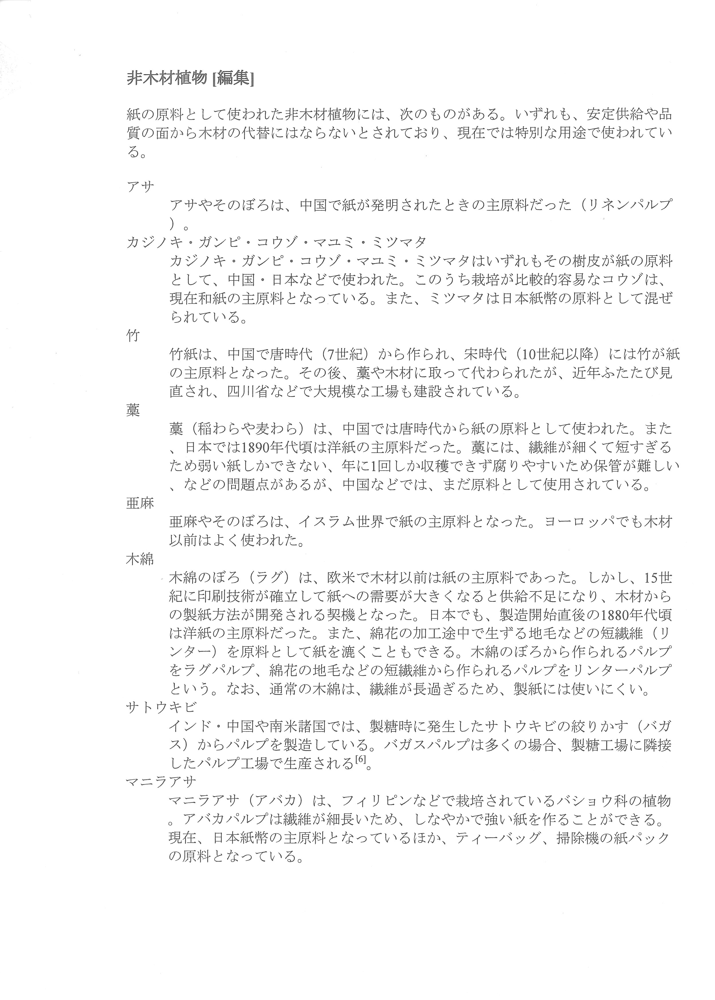

In [7]:
# data2
img = PIL.Image.open('./ocr_data/test2.jpg')
img

In [10]:
# data2 出力版
response = model.generate_content(["写真内の文字をそのまま出力してください。", img], stream=True)
response.resolve()
to_markdown(response.text)

>  非木材料物【編纂】
> 紙の原料として使われる非木本植物には、次のようなものがある。いずれも、安定供給や品質の面から木本の代替えにはならないとされており、現在では特別な用途で使われている。
> 
> アザ
> アザヤヤはその昔、中国で紙が発生したときの主要原料だった（リネンパルプとともに。中国・カンボジア・ゴヨウ・ミゾハギなどは木本であるが紙の原料として用いられたことはない。また、ミズマメは日本紙幣の原料となったことがある）。
> 
> 竹
> 竹材は、中国で春秋時代（７世紀～紀元前５世紀）頃から、秦（紀元前３世紀）に伝わった紙（幅広さ約２５ｃｍ）は、四川省で作られたもので、縦に２分割して使われた。また、日本でも１８９０年頃、中国で製造された竹紙を輸入して試験的に紙幣に使用したが、耐久性が悪く採用されなかった。現在では、トイレットペーパー、紙おむつ、紙袋などの原料となっている。
> 
> 藁
> 古くは小麦わらなどが、中国で紙の主要原料となった。ヨーロッパでも、木綿麻以外の紙は、イスラム世界で紙の主原料となった。
> 
> 木綿
> 紀元前３世紀頃、 भारतで木綿が栽培され、やがて中国に伝わった。L.H.Chenによると、中国最初の木綿栽培は唐の大暦年間（西暦７６６～７７９）であり、１５世紀に印刷技術が確立して紙需要が拡大するまで、木綿は、衣服や布団などの日用品や、燈火（とうか、油を染み込ませた芯に火をつけてともす明かり）の原料として栽培・利用されてきた。日本では、江戸時代から明治にかけて、木綿パルプ（リント）が、洋紙や半紙の原料として輸入され、今日に至るまで紙の原料とされている。
> 
> サトウキビ
> インド・中国や南米原産。糖蜜を生成したあと残渣（バガス）を原料としたパルプは、フィリピンなど東南アジア諸国で、また、メキシコやブラジルでも生産されている。
> 
> マニラ麻
> マニラ麻（アバカ）は、フィリピン原産の多年草で、おもに繊維の原料とする。日本では紙幣の主要原料となっているが、最近は産地が限られていることなどから、パルプ用マニラ麻の輸入は減少している。

In [11]:
# data2 要約版
response = model.generate_content(["写真内の文字を要約して出力してください。", img], stream=True)
response.resolve()
to_markdown(response.text)

>  非木材料物（繊維）
> 紙の原料として使われる非木本植物には、次のものがある。いずれも、安定供給や品質の面から木本の代替にはならないとされており、現在では特別な用途で使われている。
> 
> アザ
> アザヤヤはその昔、中国で紙が発明されたときの主要原料だった（リネンパルプ）とされている。中国・ヨーロッパ・アメリカなど諸説あるが、このうち最も有力な原料とされている。また、ミズアザミは日本紙幣の原料としても採用されている。
> 
> 竹
> 竹材は、中国で古くから紙の原料として使われており、宋代（１０世紀頃）には紙の主要原料となった（唐代には、麻や菜種が主原料だった）。四川省など中国南部で栽培され、日本にも古くから輸入されていた。
> 
> 藁
> 藁（稲わら）は、中国で古くから紙の原料とされてきた。前漢の時代から、麻や竹などと混入して紙がつくられた。また、日本でも１８９０年頃までは、新聞紙などに使われていたが、その後は、輸入パルプに置き換えられていった。
> 
> 木綿
> 木綿はよく燃えるため、イスラム世界で紙の主要原料となった。ヨーロッパでも、麻紙が普及するまでは、木綿を使った紙がつくられていた。
> 
> 本紙
> 紀元前３世紀頃、 भारतで木綿や麻の繊維を原料とした紙がつくられた。L.H.チェンは、 भारतで印刷技術が発明され、紙需要が拡大したことが、世界に紙を広めた要因のひとつと指摘している。また、中国では、唐の時代に、木綿や麻などの原料を原料とした紙がつくられた。日本では、平安時代初期の８１０年代に、空海（弘法大師）が、唐から製紙法を伝えたとされている。その後、鎌倉時代から室町時代にかけて、越前や土佐などで紙すきが行われるようになった。
> 
> サトイモ
> インド・中国や東南アジアで、戦国時代～江戸時代にかけて、サトイモの茎の繊維（リウゲン）からパルプをつくり、紙がつくられた。また、ミャンマーでは、現在でも、サトイモが紙の原料となっている。
> 
> マニラ麻
> マニラ麻（アバカ）は、フィリピンなど東南アジア原産の多年草の植物で、日本和紙の主要原料のひとつである。しなやかで強靭な繊維が特徴で、紙幣や証券、テッシュペーパー、紙おむつ、輸出品梱包機の紙バックの原料などに使われている。

In [ ]:
# data3
img = PIL.Image.open('./ocr_data/test3.jpg')
img

In [13]:
# data3 出力版
response = model.generate_content(["写真内の文字をそのまま出力してください。", img], stream=True)
response.resolve()
to_markdown(response.text)

>  925-609-7677

In [14]:
# data3 要約版
response = model.generate_content(["写真内の文字を要約して出力してください。", img], stream=True)
response.resolve()
to_markdown(response.text)

>  写真には「925-60F-V67F」と手書きで書かれています。

In [ ]:
# data4
img = PIL.Image.open('./test_img/img2.png')
img

In [17]:
# data4 出力版
response = model.generate_content(["写真内の文字をそのまま出力してください。", img], stream=True)
response.resolve()
to_markdown(response.text)

>  ・中国野菜は、中国原産、または中国で大きく品種改良されてきている野菜。中国から日本へ伝わった野菜の数が多いが、一般に「中国野菜」と呼んでいるものの多くは、１９７２年の日中国交正常化以降、食品専門商社の手にって中国から日本への輸出が始まってまもない野菜のことと指摘する。現在日本に出回っている中国野菜は、日本へ改良された１６種程度のものがあるといわれる。

In [18]:
# data4 要約版
response = model.generate_content(["写真内の文字を要約して出力してください。", img], stream=True)
response.resolve()
to_markdown(response.text)

>  ・中国野菜は、中国原産、または中国で大きく品種改良されてきている野菜。中国から日本へ伝わった野菜の数が多いが、一般に「中国野菜」と呼んでいるものの多くは、１９７２年の日中国交正常化以降、食品専門商社の手にって中国から日本への輸人が始まり広まっていった野菜のことと指摘する。現在日本に出回っている中国野菜は、日本でも改良され、１６種程度のものがあることが知られる。